<a href="https://colab.research.google.com/github/JamesBradbury333/blogs/blob/master/Every_great_story_seems_to_begin_with_a_snake.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Every Great Story Seems To Begin With a Snake...

There are plenty of websites attributing this arresting quote to Nicolas Cage but none it seems who can actually produce any evidence for it. I'm not sure it matters that much because it sounds cool and will work conceptually with this being my first foray into machine learning. I'm going to build an image classifyer and snakes are as good a subject as any.

I've been threatening to start learning machine learning seriously for a few years now and the distance from my university statistics courses is only increasing. With that in mind I've decided to set out on my journey and try to create something interesting in the process. With my lack of any impressive technical skills prehaps documenting my journey through the fastai course will generate something readable at least

## Set up and the boring stuff



In [1]:
!pip install -Uqq fastbook
import fastbook
fastbook.setup_book()

     |████████████████████████████████| 720 kB 7.3 MB/s 
     |████████████████████████████████| 188 kB 72.5 MB/s 
     |████████████████████████████████| 1.2 MB 54.5 MB/s 
     |████████████████████████████████| 46 kB 5.5 MB/s 
     |████████████████████████████████| 56 kB 2.9 MB/s 
     |████████████████████████████████| 51 kB 423 kB/s 
Mounted at /content/gdrive


In [11]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [12]:
from fastbook import *
from fastai.vision.widgets import *

In [13]:
import os
path = Path('images')
if not path.exists():
  path.mkdir()

# Getting Snakey Data

In [14]:
key = os.environ.get('AZURE_SEARCH_KEY', '842e78ce5fe44b5b92ab25bac752151d')

In [15]:
search_images_bing

<function fastbook.search_images_bing>

In [16]:
results = search_images_bing(key, 'african bush viper')
ims = results.attrgot('content_url')
len(ims)


150

In [17]:
ims = ['https://2.bp.blogspot.com/-alA7gm8HcSY/Uwl70C5Q7NI/AAAAAAAAEK0/IbAaa8MZL2s/s1600/African+Green+Bush+Viper+(2).jpg']

In [18]:
dest = 'images\african bush viper.jpg'
download_url(ims[0], dest)

Path('images\x07frican bush viper.jpg')

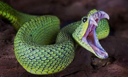

In [10]:
im = Image.open(dest)
im.to_thumb(128,128)

Get a list of snake breeds we can look at

In [19]:
snake_types = 'african bush viper', 'vine snake', 'burmese python', 'anaconda'
path = Path('snakes')

Create file directories for and download 150 images of each breed of snake

In [20]:
if not path.exists():
    path.mkdir()
    for o in snake_types:
        dest = (path/o)
        dest.mkdir(exist_ok=True)
        results = search_images_bing(key, f'{o}')
        download_images(dest, urls=results.attrgot('contentUrl'))

In [106]:
fns = get_image_files(path)
fns

(#574) [Path('snakes/burmese python/00000086.jpg'),Path('snakes/burmese python/00000001.jpg'),Path('snakes/burmese python/00000048.jpg'),Path('snakes/burmese python/00000038.jpg'),Path('snakes/burmese python/00000089.jpg'),Path('snakes/burmese python/00000028.jpg'),Path('snakes/burmese python/00000105.jpg'),Path('snakes/burmese python/00000026.jpg'),Path('snakes/burmese python/00000025.jpg'),Path('snakes/burmese python/00000088.jpg')...]

Check if any imagefailed to download properly

In [107]:
failed = verify_image(fns)
failed

False

Remove any images which failed to download properly

In [108]:
if failed:
   print(failed.map(Path.unlink))
else:
   print('All images downloaded correctly')


All images downloaded correctly


Creating a data block allows us to split our images into a training set and a test set. It has other functionality like resizing the images and creating image labels by looking in the name of the parent folder.

A Datablock is the template for a Dataloader, which allows us to pass our images to a GPU properly and do efficient calculations.

In [109]:
snakes = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128)
)

Create our Dataloader

In [110]:
dls = snakes.dataloaders(path)

/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


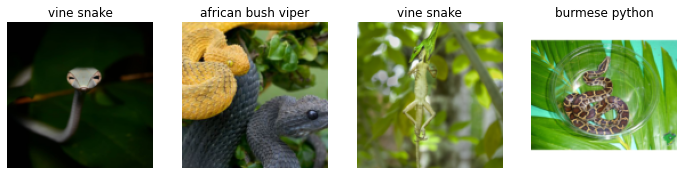

In [111]:
dls.valid.show_batch(max_n=4, nrows=1)

It is more computationally efficient if we have images of the same size as they can be loaded on to a GPU and calculated in parralel. We need to resize the images so they are uniform and the all the methods we can chose have positives and negatives

## Data Agumentation

First we can squish the images so that they are all the same dimensions. This warps the image and it may become unrecognizable but there is the posibility that the computer will learn more of the fundamental charateristics of an object. This is prehaps useful in trying to recognize natural objects but could be very unhelpful when trying to recognize the style of painting of a particular artist for example

/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


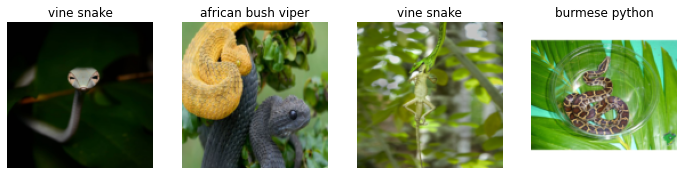

In [112]:
snakes2 = snakes.new(item_tfms=Resize(128, ResizeMethod.Squish))
dls = snakes2.dataloaders(path)
dls.valid.show_batch(max_n=4, nrows=1)

Alternatively we can pad all of the images with blocked colour. This maintains the original image but could potentially lead to the computer mistaking the blocked colour for a feature of the image and impact its predictions

/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


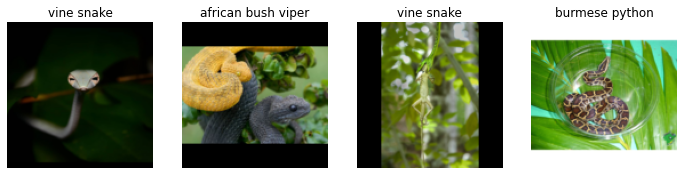

In [113]:
snakes3 = snakes.new(item_tfms=Resize(128, ResizeMethod.Pad, pad_mode='zeros'))
dls = snakes3.dataloaders(path)
dls.valid.show_batch(max_n=4, nrows=1)

Here we are randomly sampling a section of the image to create an image with the required dimensions. This is very useful as it allows us to extend our dataset as a computer can't tell that we have sent it the same image multiple times unless it is exactly the same. As this cropping is all done automatically we can't tell if the subject of the image was completely cropped out. This could lead us to confuse our model if we presented it an image without the subject

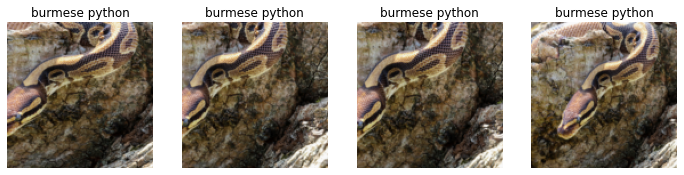

In [114]:
snakes4 = snakes.new(item_tfms=RandomResizedCrop(128, min_scale=0.3))
dls = snakes4.dataloaders(path)
dls.train.show_batch(max_n=4, nrows=1, unique=True)

FastAi researchers have found that for natural images there is a set so transformations which tend to work very well for data augmentation purposes. This involves rotations, stretches, image flips, reflections and multiple other techniques. It is worth looking into for a bespoke project, what kind of transformations are likely to be permissable and even useful

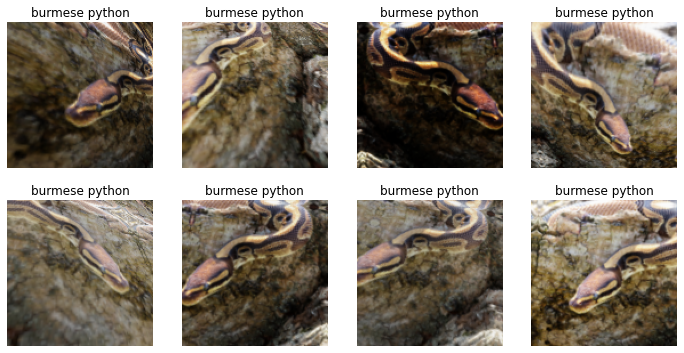

In [115]:
snakes5 = snakes.new(item_tfms=Resize(128), batch_tfms=aug_transforms(mult=2))
dls = snakes5.dataloaders(path)
dls.train.show_batch(max_n=8, nrows=2, unique=True)

# Training a model

Now we need to train a model, I'm going to try an image sampling method to begin with 

In [118]:
snakes = snakes.new(
    item_tfms=RandomResizedCrop(224, min_scale=0.5),
    batch_tfms=aug_transforms())
dls = snakes.dataloaders(path)

In [119]:
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.790605,0.674293,0.245614,00:21


/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


epoch,train_loss,valid_loss,error_rate,time
0,0.568715,0.411209,0.166667,00:21
1,0.481765,0.369312,0.131579,00:19
2,0.385818,0.332065,0.140351,00:19
3,0.320272,0.318761,0.131579,00:21


/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))
/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))
/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))
/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


Now we can look at the confusion matrix to see where our model is falling down. We can see that the model is confusing Anacondas and Pythons, these are looking snakes so this is helpful

/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


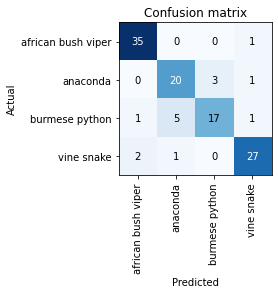

In [120]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

The model produces confidence ratings for each of the images and we can see where the model predicted wrongly and the confidences associated

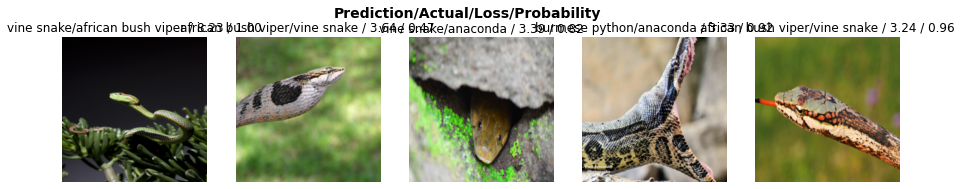

In [121]:
interp.plot_top_losses(5, nrows=1)

It is easier to clean data after you have built a model. This GUI allows you select images in the training set with the lowest confidence scores and re-label them if they are either not labeled ot not appropriate

In [122]:
cleaner = ImageClassifierCleaner(learn)
cleaner

/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))
/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


In [123]:
for idx in cleaner.delete(): cleaner.fns[idx].unlink()
for idx,cat in cleaner.change(): shutil.move(str(cleaner.fns[idx]), path/cat)

Now we have cleaned the data we can retrain

In [124]:
snakes = snakes.new(
    item_tfms=RandomResizedCrop(224, min_scale=0.5),
    batch_tfms=aug_transforms())
dls = snakes.dataloaders(path)

In [125]:
learn = cnn_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.851027,0.607129,0.219298,00:20


/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


epoch,train_loss,valid_loss,error_rate,time
0,0.713112,0.387569,0.131579,00:21
1,0.531833,0.410475,0.105263,00:21
2,0.419828,0.406325,0.096491,00:21
3,0.323637,0.409416,0.096491,00:19


/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))
/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))
/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))
/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


The data cleaning has improved the model

For what is at most a few hours learning, getting a working and reasonably successful up and running is quite satisfying. It will be interesting to dive further in and start playing with the internal 